# COVID-19 Exploratory Data Analysis - World

#### Import required libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.ticker as ticker

import warnings
warnings.filterwarnings('ignore')

%matplotlib inline

import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px

print('Libraries imported! :)')

Libraries imported! :)


#### Import data

In [2]:
data = pd.read_csv('covid_19_data.csv', sep = ',')
data.head(-3)

,SNo,ObservationDate,Province/State,Country/Region,Last Update,Confirmed,Deaths,Recovered
0,1,01/22/2020,Anhui,Mainland China,1/22/2020 17:00,1.0,0.0,0.0
1,2,01/22/2020,Beijing,Mainland China,1/22/2020 17:00,14.0,0.0,0.0
2,3,01/22/2020,Chongqing,Mainland China,1/22/2020 17:00,6.0,0.0,0.0
3,4,01/22/2020,Fujian,Mainland China,1/22/2020 17:00,1.0,0.0,0.0
4,5,01/22/2020,Gansu,Mainland China,1/22/2020 17:00,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...
156284,156285,11/15/2020,Zabaykalsky Krai,Russia,2020-11-16 05:25:57,15222.0,219.0,12262.0
156285,156286,11/15/2020,Zacatecas,Mexico,2020-11-16 05:25:57,13501.0,1120.0,0.0
156286,156287,11/15/2020,Zakarpattia Oblast,Ukraine,2020-11-16 05:25:57,19384.0,468.0,8382.0
156287,156288,11/15/2020,Zaporizhia Oblast,Ukraine,2020-11-16 05:25:57,18484.0,164.0,3021.0


In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 156292 entries, 0 to 156291
Data columns (total 8 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   SNo              156292 non-null  int64  
 1   ObservationDate  156292 non-null  object 
 2   Province/State   111979 non-null  object 
 3   Country/Region   156292 non-null  object 
 4   Last Update      156292 non-null  object 
 5   Confirmed        156292 non-null  float64
 6   Deaths           156292 non-null  float64
 7   Recovered        156292 non-null  float64
dtypes: float64(3), int64(1), object(4)
memory usage: 9.5+ MB


* Check for nan values and fill them with 'Unknown'

In [4]:
data.isna().sum()

SNo                    0
ObservationDate        0
Province/State     44313
Country/Region         0
Last Update            0
Confirmed              0
Deaths                 0
Recovered              0
dtype: int64

In [5]:
data["Province/State"]= data["Province/State"].fillna('Unknown')
data.isna().sum()

SNo                0
ObservationDate    0
Province/State     0
Country/Region     0
Last Update        0
Confirmed          0
Deaths             0
Recovered          0
dtype: int64

In [6]:
data['Country/Region'].value_counts()

US                     15430
Russia                 14066
Mainland China          9267
Japan                   8504
India                   5967
                       ...  
('St. Martin',)            1
North Ireland              1
Cape Verde                 1
Republic of Ireland        1
St. Martin                 1
Name: Country/Region, Length: 226, dtype: int64

In [7]:
# Change as China rather than Mainland China
data['Country/Region'] = data['Country/Region'].replace('Mainland China', 'China')

In [8]:
data['Active_cases'] = data['Confirmed'] - data['Deaths'] - data['Recovered']
data.head()

,SNo,ObservationDate,Province/State,Country/Region,Last Update,Confirmed,Deaths,Recovered,Active_cases
0,1,01/22/2020,Anhui,China,1/22/2020 17:00,1.0,0.0,0.0,1.0
1,2,01/22/2020,Beijing,China,1/22/2020 17:00,14.0,0.0,0.0,14.0
2,3,01/22/2020,Chongqing,China,1/22/2020 17:00,6.0,0.0,0.0,6.0
3,4,01/22/2020,Fujian,China,1/22/2020 17:00,1.0,0.0,0.0,1.0
4,5,01/22/2020,Gansu,China,1/22/2020 17:00,0.0,0.0,0.0,0.0


In [9]:
# We've gotten the latest stats
df = data[data['ObservationDate'] == max(data['ObservationDate'])].reset_index()
df.head()

,index,SNo,ObservationDate,Province/State,Country/Region,Last Update,Confirmed,Deaths,Recovered,Active_cases
0,155534,155535,11/15/2020,Unknown,Afghanistan,2020-11-16 05:25:57,43240.0,1617.0,35092.0,6531.0
1,155535,155536,11/15/2020,Unknown,Albania,2020-11-16 05:25:57,27830.0,623.0,12889.0,14318.0
2,155536,155537,11/15/2020,Unknown,Algeria,2020-11-16 05:25:57,67679.0,2154.0,44633.0,20892.0
3,155537,155538,11/15/2020,Unknown,Andorra,2020-11-16 05:25:57,5872.0,76.0,4747.0,1049.0
4,155538,155539,11/15/2020,Unknown,Angola,2020-11-16 05:25:57,13451.0,322.0,6444.0,6685.0


In [10]:
df_world = df.groupby(["ObservationDate"])[["Confirmed","Active_cases","Recovered","Deaths"]].sum().reset_index()
df_world.head()

,ObservationDate,Confirmed,Active_cases,Recovered,Deaths
0,11/15/2020,54370186.0,18097899.0,34955148.0,1317139.0


## EDA

In [11]:
labels = ["Active Cases","Recovered","Deaths"]
values = df_world.loc[0, ["Active_cases","Recovered","Deaths"]]
fig = px.pie(df_world, values=values, names=labels,color_discrete_sequence=['rgb(77,146,33)','rgb(69,144,185)','rgb(77,77,77)'],hole=0.7)
fig.update_layout(
    title='Total cases in the world : '+str(df_world["Confirmed"][0]),
)
fig.show()

In [12]:
by_time_data = data.groupby(["ObservationDate"])[
    ["Confirmed","Active_cases","Recovered","Deaths"]].sum().reset_index().sort_values("ObservationDate",ascending=True).reset_index(drop=True)
by_time_data.head(-4)    

,ObservationDate,Confirmed,Active_cases,Recovered,Deaths
0,01/22/2020,555.0,510.0,28.0,17.0
1,01/23/2020,653.0,605.0,30.0,18.0
2,01/24/2020,941.0,879.0,36.0,26.0
3,01/25/2020,1438.0,1357.0,39.0,42.0
4,01/26/2020,2118.0,2010.0,52.0,56.0
...,...,...,...,...,...
290,11/07/2020,49886987.0,15856342.0,32779541.0,1251104.0
291,11/08/2020,50451833.0,16162229.0,33032762.0,1256842.0
292,11/09/2020,50918936.0,16365568.0,33289404.0,1263964.0
293,11/10/2020,51460740.0,16643710.0,33544236.0,1272794.0


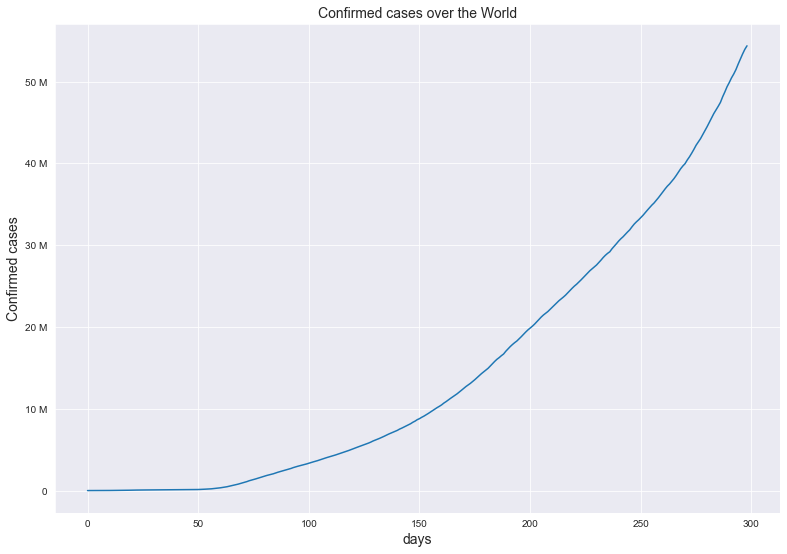

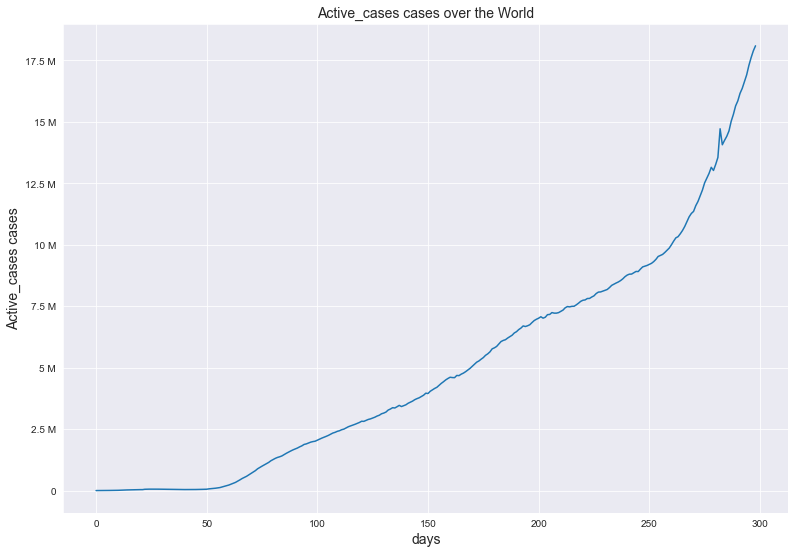

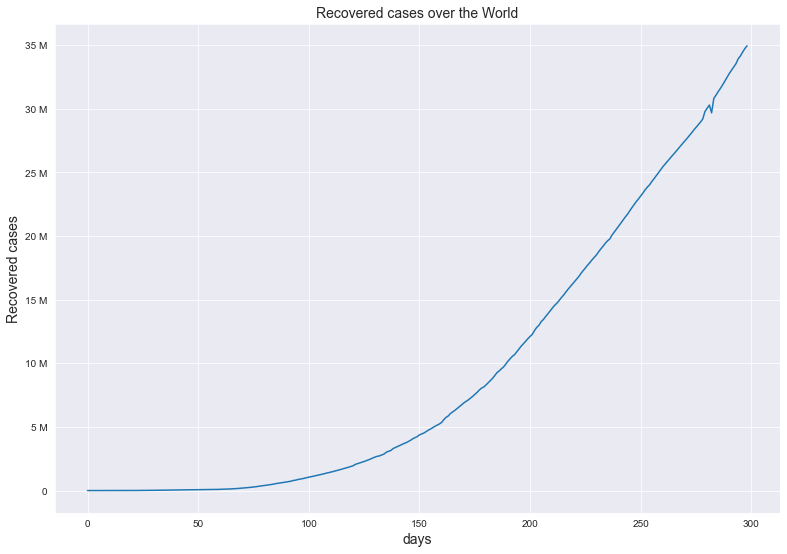

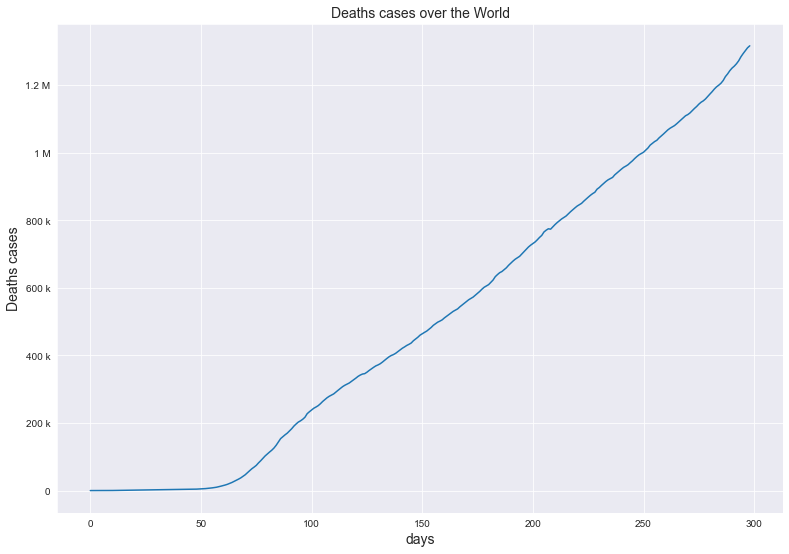

In [13]:
columns = ['Confirmed', 'Active_cases', 'Recovered', 'Deaths']

sns.set_style("darkgrid")
for each in columns:
    fig, ax = plt.subplots(figsize=(13, 9))
    sns.lineplot(x = by_time_data.index, y = each, data = by_time_data)
    plt.xlabel('days', fontsize = 14)
    plt.ylabel(str(each) + ' cases', fontsize = 14)
    plt.title(str(each) + ' cases over the World', fontsize = 14)
    ax.yaxis.set_major_formatter(ticker.EngFormatter())
    plt.show()

In [14]:
each_country_data = df.groupby(["Country/Region"])["Confirmed","Active_cases","Recovered","Deaths"].sum().reset_index().sort_values("Confirmed",ascending=False).reset_index(drop=True)

In [15]:
headerColor = 'grey'
rowEvenColor = 'lightgrey'
rowOddColor = 'white'

fig = go.Figure(data=[go.Table(
  header=dict(
    values=['<b>Country</b>','<b>Confirmed Cases</b>'],
    line_color='darkslategray',
    fill_color=headerColor,
    align=['left','center'],
      
    font=dict(color='white', size=12)
  ),
  cells=dict(
    values=[
      each_country_data['Country/Region'],
      each_country_data['Confirmed'],
      ],
    line_color='darkslategray',
    # 2-D list of colors for alternating rows
    fill_color = [[rowOddColor,rowEvenColor,rowOddColor, rowEvenColor,rowOddColor]*len(each_country_data)],
    align = ['left', 'center'],
    font = dict(color = 'darkslategray', size = 11)
    ))
])
fig.update_layout(
    title='Confirmed Cases In Each Country',
)
fig.show()

In [16]:
each_country_data.head()

,Country/Region,Confirmed,Active_cases,Recovered,Deaths
0,US,11036935.0,6615837.0,4174884.0,246214.0
1,India,8845127.0,465478.0,8249579.0,130070.0
2,Brazil,5863093.0,417843.0,5279452.0,165798.0
3,France,1915713.0,1733352.0,139760.0,42601.0
4,Russia,1910149.0,447699.0,1429565.0,32885.0


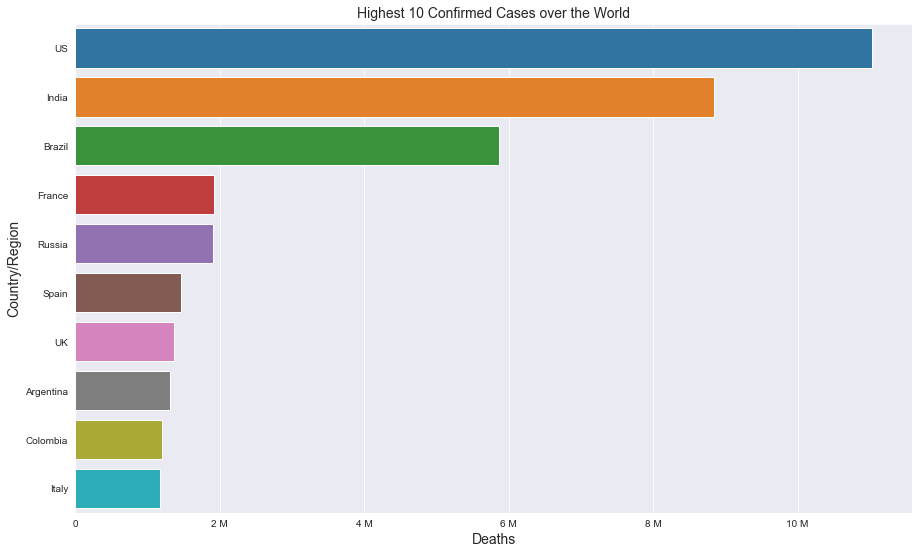

In [17]:
sns.set_style("darkgrid")
plt.figure(figsize= (15,9))
ax = sns.barplot(x = each_country_data.iloc[:10,1], y = each_country_data.iloc[:10,0], data = each_country_data)
plt.xlabel('Deaths', fontsize = 14)
plt.ylabel('Country/Region', fontsize = 14)
plt.title('Highest 10 Confirmed Cases over the World', fontsize = 14)
ax.xaxis.set_major_formatter(ticker.EngFormatter())
plt.show()

In [18]:
sorted_active_cases = (each_country_data.sort_values(by = ['Active_cases'], ascending = False).reset_index(drop = True))
sorted_active_cases.head(-3)

,Country/Region,Confirmed,Active_cases,Recovered,Deaths
0,US,11036935.0,6615837.0,4174884.0,246214.0
1,France,1915713.0,1733352.0,139760.0,42601.0
2,UK,1372884.0,1317737.0,3121.0,52026.0
3,Spain,1458591.0,1267446.0,150376.0,40769.0
4,Italy,1178529.0,712490.0,420810.0,45229.0
...,...,...,...,...,...
185,Laos,24.0,1.0,23.0,0.0
186,Western Sahara,10.0,1.0,8.0,1.0
187,Vanuatu,1.0,1.0,0.0,0.0
188,Macau,46.0,0.0,46.0,0.0


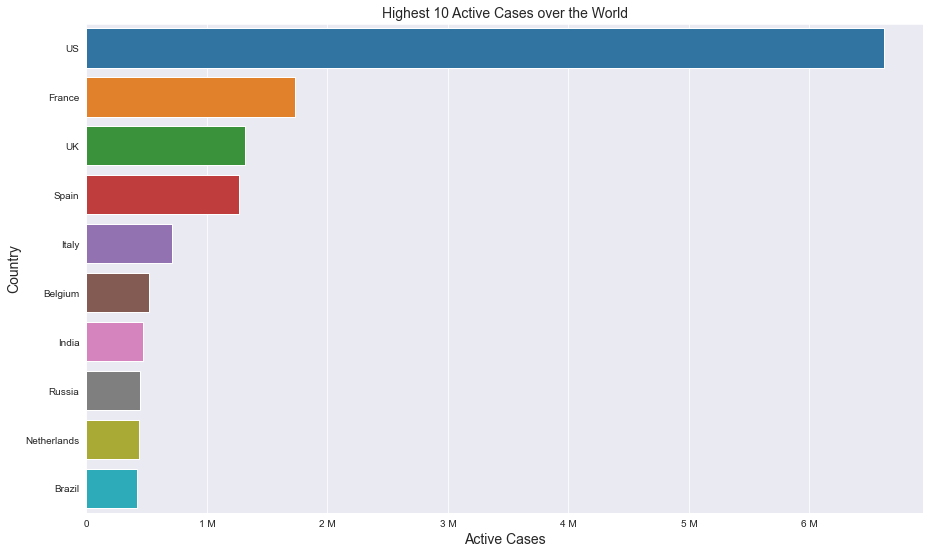

In [19]:
sns.set_style("darkgrid")
plt.figure(figsize= (15,9))
ax = sns.barplot(x = sorted_active_cases.iloc[:10,2], y = sorted_active_cases.iloc[:10,0], data = sorted_active_cases)
plt.xlabel('Active Cases', fontsize = 14)
plt.ylabel('Country', fontsize = 14)
plt.title('Highest 10 Active Cases over the World', fontsize = 14)
ax.xaxis.set_major_formatter(ticker.EngFormatter())
plt.show()

In [20]:
sorted_recovered_cases = (each_country_data.sort_values(by = ['Recovered'], ascending = False).reset_index(drop = True))
sorted_recovered_cases.head(-3)

,Country/Region,Confirmed,Active_cases,Recovered,Deaths
0,India,8845127.0,465478.0,8249579.0,130070.0
1,Brazil,5863093.0,417843.0,5279452.0,165798.0
2,US,11036935.0,6615837.0,4174884.0,246214.0
3,Russia,1910149.0,447699.0,1429565.0,32885.0
4,Argentina,1310491.0,145953.0,1129102.0,35436.0
...,...,...,...,...,...
185,Western Sahara,10.0,1.0,8.0,1.0
186,Solomon Islands,16.0,11.0,5.0,0.0
187,Marshall Islands,1.0,0.0,1.0,0.0
188,MS Zaandam,9.0,7.0,0.0,2.0


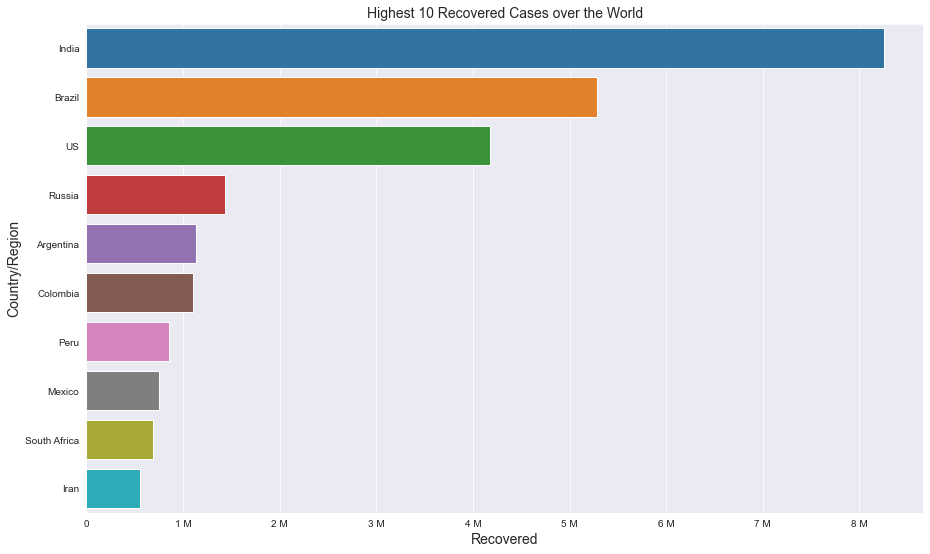

In [21]:
sns.set_style("darkgrid")
plt.figure(figsize= (15,9))
ax = sns.barplot(x = sorted_recovered_cases.iloc[:10,3], y = sorted_recovered_cases.iloc[:10,0], data = sorted_recovered_cases)
plt.xlabel('Recovered', fontsize = 14)
plt.ylabel('Country/Region', fontsize = 14)
plt.title('Highest 10 Recovered Cases over the World', fontsize = 14)
ax.xaxis.set_major_formatter(ticker.EngFormatter())
plt.show()

In [22]:
sorted_death_cases = (each_country_data.sort_values(by = ['Deaths'], ascending = False).reset_index(drop = True))
sorted_death_cases.head(-3)

,Country/Region,Confirmed,Active_cases,Recovered,Deaths
0,US,11036935.0,6615837.0,4174884.0,246214.0
1,Brazil,5863093.0,417843.0,5279452.0,165798.0
2,India,8845127.0,465478.0,8249579.0,130070.0
3,Mexico,1006522.0,157790.0,750190.0,98542.0
4,UK,1372884.0,1317737.0,3121.0,52026.0
...,...,...,...,...,...
185,Macau,46.0,0.0,46.0,0.0
186,Dominica,68.0,27.0,41.0,0.0
187,Seychelles,160.0,3.0,157.0,0.0
188,Cambodia,302.0,13.0,289.0,0.0


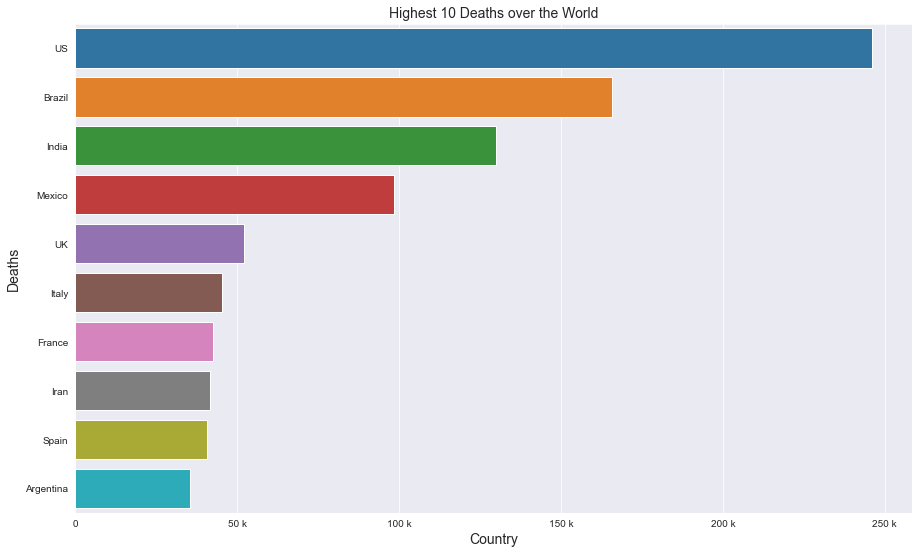

In [23]:
sns.set_style("darkgrid")
plt.figure(figsize= (15,9))
ax = sns.barplot(x = sorted_death_cases.iloc[:10,4], y = sorted_death_cases.iloc[:10,0], data = sorted_death_cases)
plt.xlabel('Country', fontsize = 14)
plt.ylabel('Deaths', fontsize = 14)
plt.title('Highest 10 Deaths over the World', fontsize = 14)
ax.xaxis.set_major_formatter(ticker.EngFormatter())
plt.show()

In [24]:
data_corona_evolution = data.groupby(["Country/Region","ObservationDate"])[["Confirmed","Active_cases","Recovered","Deaths"]].sum().reset_index().sort_values("ObservationDate",ascending=True).reset_index(drop=True)

for each in columns:    
    fig = px.choropleth(data_corona_evolution, locations=data_corona_evolution['Country/Region'],
                        color=data_corona_evolution[each],locationmode='country names', 
                        hover_name=data_corona_evolution['Country/Region'], 
                        color_continuous_scale=px.colors.sequential.deep,
                        animation_frame="ObservationDate")
    fig.update_layout(

        title='Evolution of ' +str(each) + ' cases In Each Country',
    )
    fig.show()

In [25]:
fig = go.Figure(data=[go.Scatter(
    x=each_country_data['Country/Region'][0:10],
    y=each_country_data['Confirmed'][0:10],
    mode='markers',
    
    marker=dict(
        color=100+np.random.randn(500),
        size=(each_country_data['Confirmed'][0:10]/45000),
        showscale=True
        )
)])

fig.update_layout(
    title='Most 10 Infected Countries',
    xaxis_title="Countries",
    yaxis_title="Confirmed Cases",
    template='plotly_dark'
)
fig.show()